<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#loading-weights..." data-toc-modified-id="loading-weights...-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>loading weights...</a></span></li><li><span><a href="#计算验证集准确率（阈值0.9）" data-toc-modified-id="计算验证集准确率（阈值0.9）-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>计算验证集准确率（阈值0.9）</a></span></li><li><span><a href="#阈值0.9" data-toc-modified-id="阈值0.9-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>阈值0.9</a></span></li><li><span><a href="#载入选择好的模型并预测" data-toc-modified-id="载入选择好的模型并预测-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>载入选择好的模型并预测</a></span></li></ul></div>

In [23]:
%config InlineBackend.figure_format = 'retina'

In [24]:
#test

# loading weights...

In [25]:
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.backends.cudnn as cudnn
from PIL import Image

from nets.siamese import Siamese as siamese
from utils.utils import letterbox_image, preprocess_input, cvtColor, show_config


#---------------------------------------------------#
#   使用自己训练好的模型预测需要修改model_path参数
#---------------------------------------------------#
class Siamese(object):
    _defaults = {
        #-----------------------------------------------------#
        #   使用自己训练好的模型进行预测一定要修改model_path
        #   model_path指向logs文件夹下的权值文件
        #-----------------------------------------------------#
        "model_path"        : 'logs_cuda_7_sgd/best_epoch_weights.pth',
        #-----------------------------------------------------#
        #   输入图片的大小。
        #-----------------------------------------------------#
        "input_shape"       : [128, 128],
        #--------------------------------------------------------------------#
        #   该变量用于控制是否使用letterbox_image对输入图像进行不失真的resize
        #   否则对图像进行CenterCrop
        #--------------------------------------------------------------------#
        "letterbox_image"   : True,
        #-------------------------------#
        #   是否使用Cuda
        #   没有GPU可以设置成False
        #-------------------------------#
        "cuda"              : False
    }

    @classmethod
    def get_defaults(cls, n):
        if n in cls._defaults:
            return cls._defaults[n]
        else:
            return "Unrecognized attribute name '" + n + "'"

    #---------------------------------------------------#
    #   初始化Siamese
    #---------------------------------------------------#
    def __init__(self, **kwargs):
        self.__dict__.update(self._defaults)
        for name, value in kwargs.items():
            setattr(self, name, value)
        self.generate()
        
        show_config(**self._defaults)
        
    #---------------------------------------------------#
    #   载入模型
    #---------------------------------------------------#
    def generate(self):
        #---------------------------#
        #   载入模型与权值
        #---------------------------#
        print('Loading weights into state dict...')
        device  = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        model   = siamese(self.input_shape)
        model.load_state_dict(torch.load(self.model_path, map_location=device))
        self.net = model.eval()
        print('{} model loaded.'.format(self.model_path))

        if self.cuda:
            self.net = torch.nn.DataParallel(self.net)
            cudnn.benchmark = True
            self.net = self.net.cuda()
    
    def letterbox_image(self, image, size):
        image   = image.convert("RGB")
        iw, ih  = image.size
        w, h    = size
        scale   = min(w/iw, h/ih)
        nw      = int(iw*scale)
        nh      = int(ih*scale)

        image       = image.resize((nw,nh), Image.BICUBIC)
        new_image   = Image.new('RGB', size, (128,128,128))
        new_image.paste(image, ((w-nw)//2, (h-nh)//2))
        if self.input_shape[-1]==1:
            new_image = new_image.convert("L")
        return new_image
        
    #---------------------------------------------------#
    #   检测图片
    #---------------------------------------------------#
    def detect_image(self, image_1, image_2):
        #---------------------------------------------------------#
        #   在这里将图像转换成RGB图像，防止灰度图在预测时报错。
        #---------------------------------------------------------#
        image_1 = cvtColor(image_1)
        image_2 = cvtColor(image_2)
        
        #---------------------------------------------------#
        #   对输入图像进行不失真的resize
        #---------------------------------------------------#
        image_1 = letterbox_image(image_1, [self.input_shape[1], self.input_shape[0]], self.letterbox_image)
        image_2 = letterbox_image(image_2, [self.input_shape[1], self.input_shape[0]], self.letterbox_image)
        
        #---------------------------------------------------------#
        #   归一化+添加上batch_size维度
        #---------------------------------------------------------#
        photo_1  = preprocess_input(np.array(image_1, np.float32))
        photo_2  = preprocess_input(np.array(image_2, np.float32))

        with torch.no_grad():
            #---------------------------------------------------#
            #   添加上batch维度，才可以放入网络中预测
            #---------------------------------------------------#
            photo_1 = torch.from_numpy(np.expand_dims(np.transpose(photo_1, (2, 0, 1)), 0)).type(torch.FloatTensor)
            photo_2 = torch.from_numpy(np.expand_dims(np.transpose(photo_2, (2, 0, 1)), 0)).type(torch.FloatTensor)
            
            if self.cuda:
                photo_1 = photo_1.cuda()
                photo_2 = photo_2.cuda()
                
            #---------------------------------------------------#
            #   获得预测结果，output输出为概率
            #---------------------------------------------------#
            output = self.net([photo_1, photo_2])[0]
            output = torch.nn.Sigmoid()(output)

        plt.subplot(1, 2, 1)
        plt.imshow(np.array(image_1))

        plt.subplot(1, 2, 2)
        plt.imshow(np.array(image_2))
        plt.text(-12, -12, 'Similarity:%.3f' % output, ha='center', va= 'bottom',fontsize=11)
        plt.show()
        return output


Loading weights into state dict...
logs_cuda_6_sgd/ep140-loss0.162-val_loss0.071.pth model loaded.
Configurations:
----------------------------------------------------------------------
|                     keys |                                   values|
----------------------------------------------------------------------
|               model_path | logs_cuda_6_sgd/ep140-loss0.162-val_loss0.071.pth|
|              input_shape |                               [128, 128]|
|          letterbox_image |                                     True|
|                     cuda |                                    False|
----------------------------------------------------------------------
Input image_1 filename:/home/yqzhou/ML-final/data/掌静脉验证/0001/0001原图_0.bmp
Input image_2 filename:/home/yqzhou/ML-final/data/掌静脉验证/0001/0001原图_0.bmp


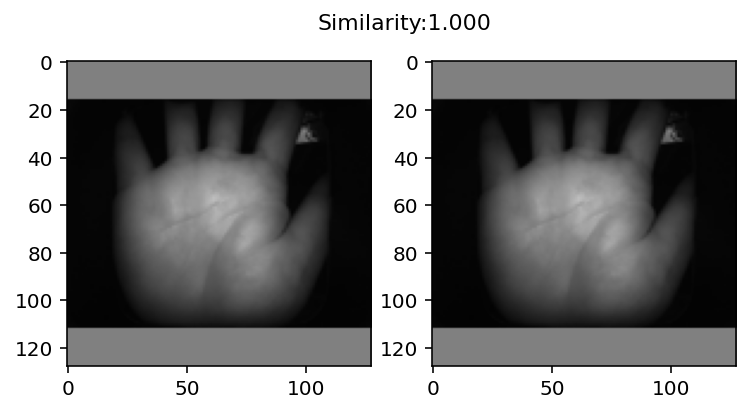

tensor([0.9998])


KeyboardInterrupt: Interrupted by user

In [12]:
import numpy as np
from PIL import Image

#from siamese import Siamese

if __name__ == "__main__":
    model = Siamese()
        
    while True:
        image_1 = input('Input image_1 filename:')
        try:
            image_1 = Image.open(image_1)
        except:
            print('Image_1 Open Error! Try again!')
            continue

        image_2 = input('Input image_2 filename:')
        try:
            image_2 = Image.open(image_2)
        except:
            print('Image_2 Open Error! Try again!')
            continue
        probability = model.detect_image(image_1,image_2)
        print(probability)


# 计算验证集准确率（阈值0.9）

In [4]:
import os
data_dir = '/home/yqzhou/ML-final/data/valid/valid_roi_clahe/'#文件地址/名称
classes = os.listdir(data_dir)

In [90]:
# 由于os.listdir读进来的文件不是按照原始的顺序的，所以在测试的时候我们要排序！
# 在验证集上可以不考虑这个哈
#classes.sort()
#classes

In [91]:
# test
#data_dir = '/home/yqzhou/ML-final/data/掌静脉验证/'#文件地址/名称
#classes = os.listdir(data_dir)
#classes
#classes.sort()
#cls='0001'
#files = os.listdir(data_dir+cls)
#files

In [26]:
import os
data_dir = '/home/yqzhou/ML-final/data/valid/valid_roi_clahe/'#文件地址/名称
classes = os.listdir(data_dir)
#classes.sort(key=lambda x:int(x[:-4]))
#classes.sort()
cls = classes[0]
files = os.listdir(data_dir+cls)
files[0]

'first_img.jpg'

In [27]:
# debug......

In [28]:
#data_dir = '/home/yqzhou/ML-final/data/valid/valid_roi_clahe/'#文件地址/名称
#classes = os.listdir(data_dir)

In [29]:
#classes

In [30]:
#classes.sort(key=lambda x:x[-2:])
#classes

In [31]:
# debug end......

Loading weights into state dict...
logs_cuda_7_sgd/best_epoch_weights.pth model loaded.
Configurations:
----------------------------------------------------------------------
|                     keys |                                   values|
----------------------------------------------------------------------
|               model_path |   logs_cuda_7_sgd/best_epoch_weights.pth|
|              input_shape |                               [128, 128]|
|          letterbox_image |                                     True|
|                     cuda |                                    False|
----------------------------------------------------------------------


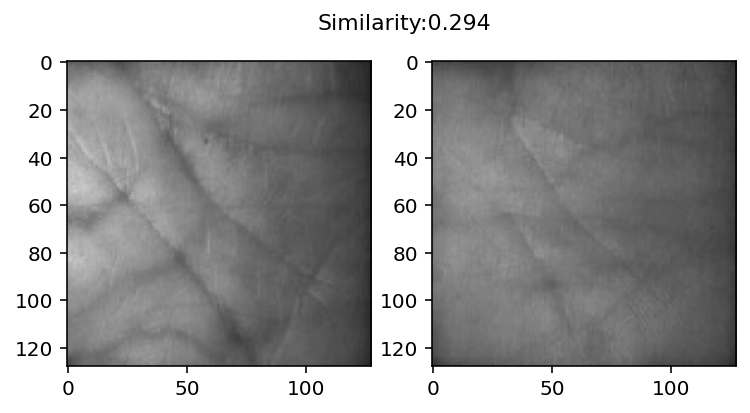

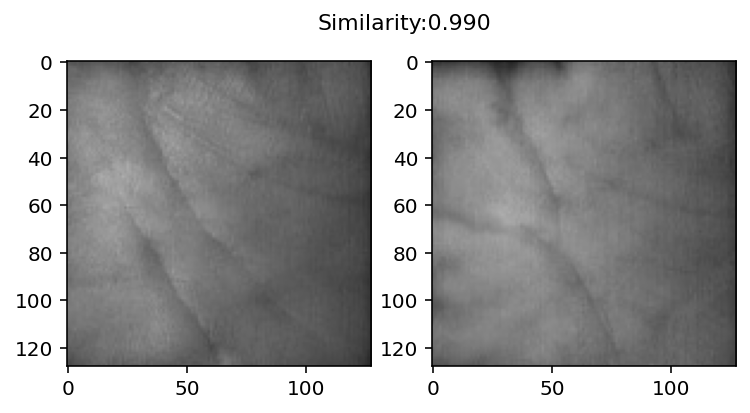

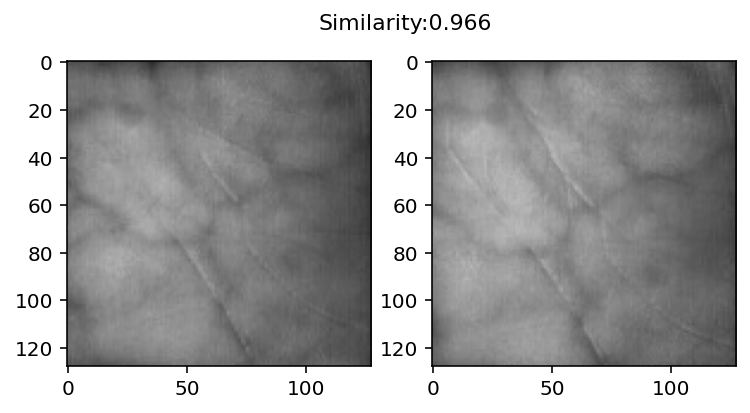

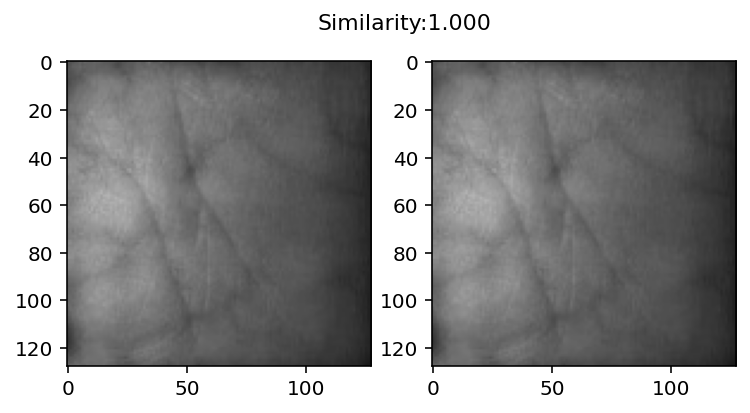

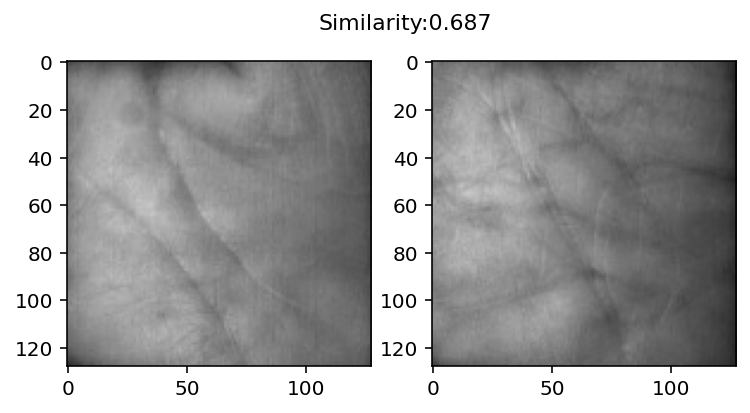

...

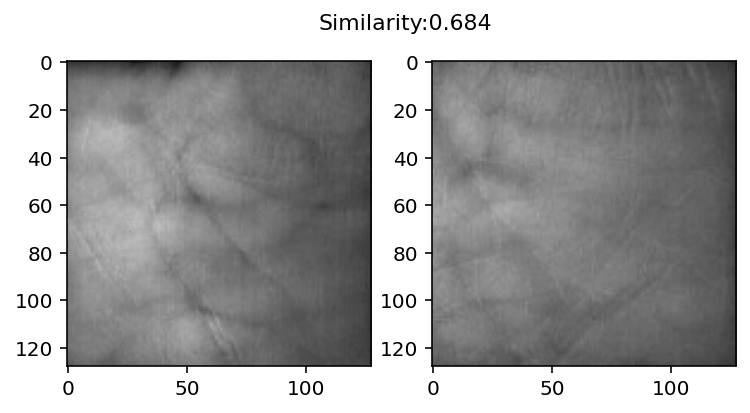

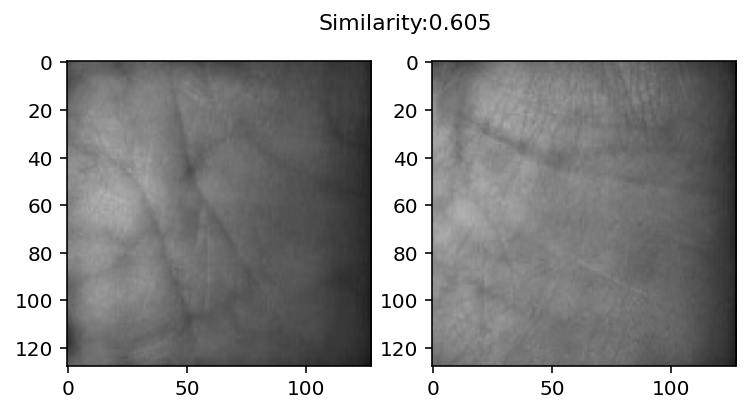

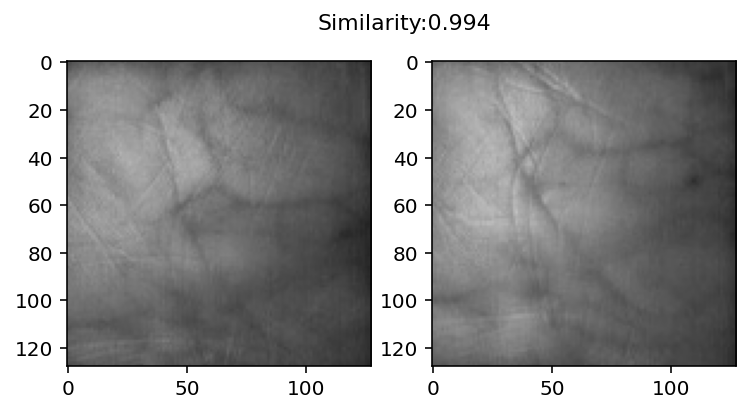

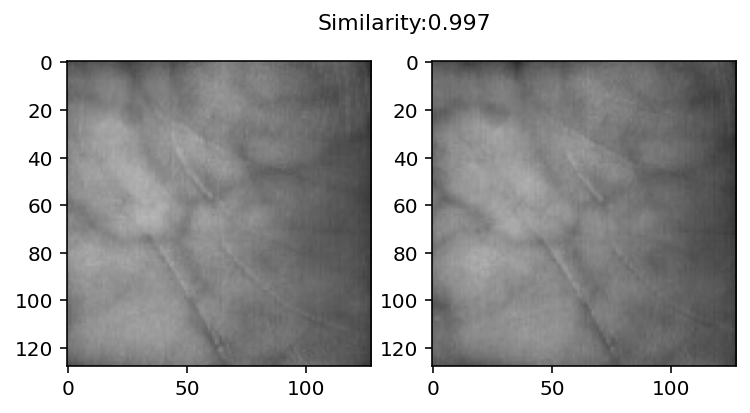

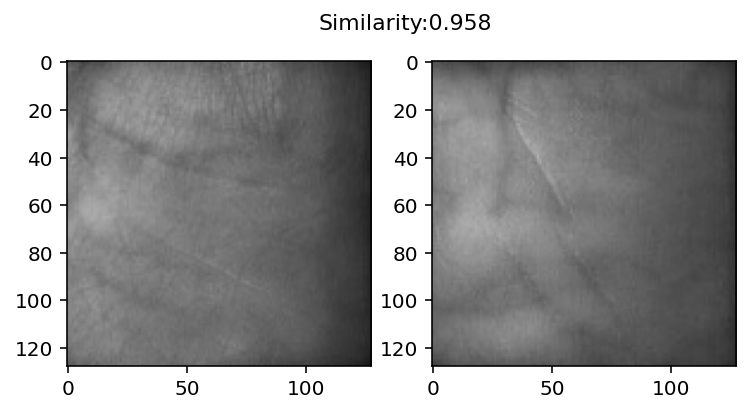

In [32]:
model = Siamese()
    
data_dir = '/home/yqzhou/ML-final/data/valid/valid_roi_clahe/'#文件地址/名称
label=[0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0]

classes = os.listdir(data_dir)
prob_record = []
for cls in classes:
    files = os.listdir(data_dir+cls)
    image_1 = Image.open(data_dir+cls+"/"+files[0])
    image_2 = Image.open(data_dir+cls+"/"+files[1])

    probability = model.detect_image(image_1,image_2)
    prob_record.append(probability)

!!!!wait to write a function, to see the idx of the probability of similarity is between 0.8-0.9, and we use eyes to see if these two pic are the same.

In [33]:
prob_record

[tensor([0.2938]),
 tensor([0.9902]),
 tensor([0.9664]),
 tensor([0.9999]),
 tensor([0.6869]),
 tensor([0.6957]),
 tensor([0.5676]),
 tensor([0.6762]),
 tensor([0.9182]),
 tensor([0.9501]),
 tensor([0.9999]),
 tensor([0.9999]),
 tensor([0.9865]),
 tensor([0.9936]),
 tensor([0.9999]),
 tensor([0.9945]),
 tensor([0.9688]),
 tensor([0.7988]),
 tensor([0.9746]),
 tensor([0.9969]),
 tensor([0.3861]),
 tensor([0.9999]),
 tensor([0.0201]),
 tensor([0.9955]),
 tensor([0.8051]),
 tensor([0.6762]),
 tensor([0.5640]),
 tensor([0.1288]),
 tensor([0.9930]),
 tensor([0.3950]),
 tensor([0.9087]),
 tensor([0.6007]),
 tensor([0.9999]),
 tensor([0.6874]),
 tensor([0.8157]),
 tensor([0.6919]),
 tensor([0.9499]),
 tensor([0.7428]),
 tensor([0.9999]),
 tensor([0.8358]),
 tensor([0.9400]),
 tensor([0.9990]),
 tensor([0.9999]),
 tensor([0.9923]),
 tensor([0.6068]),
 tensor([0.9588]),
 tensor([0.9973]),
 tensor([0.7861]),
 tensor([0.1503]),
 tensor([0.9968]),
 tensor([0.9999]),
 tensor([0.8705]),
 tensor([0.7

In [34]:
pb_re = np.array([])
for i in prob_record:
    tmp = i.numpy()
    pb_re = np.append(pb_re, tmp)


In [35]:
len(pb_re)

180

In [36]:
sum(np.array(label)==1) # 同一个人

90

In [37]:
sum(pb_re>=0.9)

109

In [38]:
sum(np.array(label)==0) # 不同人

90

In [39]:
sum(pb_re<0.9)

71

In [94]:
y_pred = []
for i in pb_re.tolist():
    if i>=0.9:
        y_pred.append(1)
    else:
        y_pred.append(0)
#y_pred

In [95]:
sum(np.array(y_pred)==np.array(label))

161

In [96]:
sum(np.array(y_pred)==np.array(label))/180

0.8944444444444445

# 阈值0.9

扩增图片-ok

- 如果设置阈值为0.9才判断是同一个人的话，6.0的准确率为83.88%, epochs=16

- 如果设置阈值为0.93才判断是同一个人的话，6.0的准确率为85%, epochs=16

- 如果设置阈值为0.90才判断是同一个人的话，6.0的准确率为87.77%, epochs=20

- 如果设置阈值为0.95才判断是同一个人的话，6.0的准确率为92.77%, epochs=best weight's

- 如果设置阈值为0.95才判断是同一个人的话，6.0的准确率为93.33%, epochs=150

- 如果设置阈值为0.95才判断是同一个人的话，6.0的准确率为93.33%, epochs=140

- 如果设置阈值为0.95才判断是同一个人的话，6.0的准确率为91.66%, epochs=130






- 如果设置阈值为0.90才判断是同一个人的话，7.0的准确率为86.66%, epochs=20

- 如果设置阈值为0.95才判断是同一个人的话，7.0的准确率为87.22%, epochs=55

- 如果设置阈值为0.95才判断是同一个人的话，7.0的准确率为88.88%, epochs=67

- 如果设置阈值为0.95才判断是同一个人的话，7.0的准确率为92.22%, epochs=best

综上所述，选择epochs=140的weights，（6.0的结果），然后选阈值为0.95来判断，好一点？

下面就是选择该权重下的模型载入，然后自己试试放别的图片进去看准确率如何。。。

# 载入选择好的模型并预测

In [37]:
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.backends.cudnn as cudnn
from PIL import Image

from nets.siamese import Siamese as siamese
from utils.utils import letterbox_image, preprocess_input, cvtColor, show_config


#---------------------------------------------------#
#   使用自己训练好的模型预测需要修改model_path参数
#---------------------------------------------------#
class Siamese(object):
    _defaults = {
        #-----------------------------------------------------#
        #   使用自己训练好的模型进行预测一定要修改model_path
        #   model_path指向logs文件夹下的权值文件
        #-----------------------------------------------------#
        "model_path"        : 'logs_cuda_6_sgd/ep140-loss0.162-val_loss0.071.pth',
        #-----------------------------------------------------#
        #   输入图片的大小。
        #-----------------------------------------------------#
        "input_shape"       : [128, 128],
        #--------------------------------------------------------------------#
        #   该变量用于控制是否使用letterbox_image对输入图像进行不失真的resize
        #   否则对图像进行CenterCrop
        #--------------------------------------------------------------------#
        "letterbox_image"   : True,
        #-------------------------------#
        #   是否使用Cuda
        #   没有GPU可以设置成False
        #-------------------------------#
        "cuda"              : False
    }

    @classmethod
    def get_defaults(cls, n):
        if n in cls._defaults:
            return cls._defaults[n]
        else:
            return "Unrecognized attribute name '" + n + "'"

    #---------------------------------------------------#
    #   初始化Siamese
    #---------------------------------------------------#
    def __init__(self, **kwargs):
        self.__dict__.update(self._defaults)
        for name, value in kwargs.items():
            setattr(self, name, value)
        self.generate()
        
        show_config(**self._defaults)
        
    #---------------------------------------------------#
    #   载入模型
    #---------------------------------------------------#
    def generate(self):
        #---------------------------#
        #   载入模型与权值
        #---------------------------#
        print('Loading weights into state dict...')
        device  = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        model   = siamese(self.input_shape)
        model.load_state_dict(torch.load(self.model_path, map_location=device))
        self.net = model.eval()
        print('{} model loaded.'.format(self.model_path))

        if self.cuda:
            self.net = torch.nn.DataParallel(self.net)
            cudnn.benchmark = True
            self.net = self.net.cuda()
    
    def letterbox_image(self, image, size):
        image   = image.convert("RGB")
        iw, ih  = image.size
        w, h    = size
        scale   = min(w/iw, h/ih)
        nw      = int(iw*scale)
        nh      = int(ih*scale)

        image       = image.resize((nw,nh), Image.BICUBIC)
        new_image   = Image.new('RGB', size, (128,128,128))
        new_image.paste(image, ((w-nw)//2, (h-nh)//2))
        if self.input_shape[-1]==1:
            new_image = new_image.convert("L")
        return new_image
        
    #---------------------------------------------------#
    #   检测图片
    #---------------------------------------------------#
    def detect_image(self, image_1, image_2):
        #---------------------------------------------------------#
        #   在这里将图像转换成RGB图像，防止灰度图在预测时报错。
        #---------------------------------------------------------#
        image_1 = cvtColor(image_1)
        image_2 = cvtColor(image_2)
        
        #---------------------------------------------------#
        #   对输入图像进行不失真的resize
        #---------------------------------------------------#
        image_1 = letterbox_image(image_1, [self.input_shape[1], self.input_shape[0]], self.letterbox_image)
        image_2 = letterbox_image(image_2, [self.input_shape[1], self.input_shape[0]], self.letterbox_image)
        
        #---------------------------------------------------------#
        #   归一化+添加上batch_size维度
        #---------------------------------------------------------#
        photo_1  = preprocess_input(np.array(image_1, np.float32))
        photo_2  = preprocess_input(np.array(image_2, np.float32))

        with torch.no_grad():
            #---------------------------------------------------#
            #   添加上batch维度，才可以放入网络中预测
            #---------------------------------------------------#
            photo_1 = torch.from_numpy(np.expand_dims(np.transpose(photo_1, (2, 0, 1)), 0)).type(torch.FloatTensor)
            photo_2 = torch.from_numpy(np.expand_dims(np.transpose(photo_2, (2, 0, 1)), 0)).type(torch.FloatTensor)
            
            if self.cuda:
                photo_1 = photo_1.cuda()
                photo_2 = photo_2.cuda()
                
            #---------------------------------------------------#
            #   获得预测结果，output输出为概率
            #---------------------------------------------------#
            output = self.net([photo_1, photo_2])[0]
            output = torch.nn.Sigmoid()(output)

        plt.subplot(1, 2, 1)
        plt.imshow(np.array(image_1))

        plt.subplot(1, 2, 2)
        plt.imshow(np.array(image_2))
        plt.text(-12, -12, 'Similarity:%.3f' % output, ha='center', va= 'bottom',fontsize=11)
        plt.show()
        return output


Loading weights into state dict...
logs_cuda_6_sgd/ep140-loss0.162-val_loss0.071.pth model loaded.
Configurations:
----------------------------------------------------------------------
|                     keys |                                   values|
----------------------------------------------------------------------
|               model_path | logs_cuda_6_sgd/ep140-loss0.162-val_loss0.071.pth|
|              input_shape |                               [128, 128]|
|          letterbox_image |                                     True|
|                     cuda |                                    False|
----------------------------------------------------------------------
Input image_1 filename:/home/yqzhou//ML-final/data/掌静脉验证/0001/0001原图_0.bmp
Input image_2 filename:/home/yqzhou//ML-final/data/掌静脉验证/0001/0001原图_1.bmp


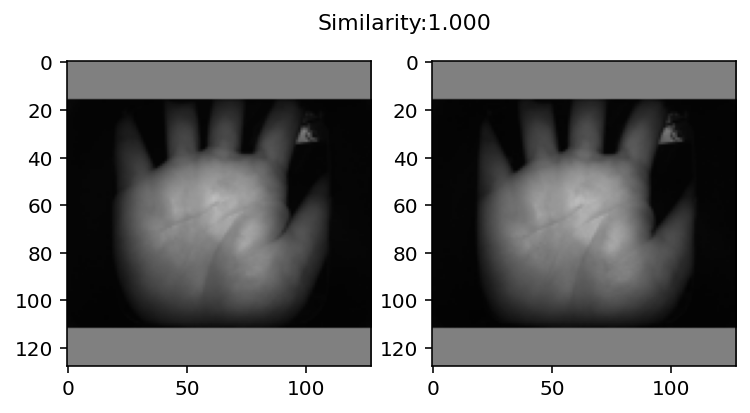

tensor([0.9997])
same hand(1)


KeyboardInterrupt: Interrupted by user

In [134]:
import numpy as np
from PIL import Image

#from siamese import Siamese

if __name__ == "__main__":
    model = Siamese()
        
    while True:
        image_1 = input('Input image_1 filename:')
        try:
            image_1 = Image.open(image_1)
        except:
            print('Image_1 Open Error! Try again!')
            continue

        image_2 = input('Input image_2 filename:')
        try:
            image_2 = Image.open(image_2)
        except:
            print('Image_2 Open Error! Try again!')
            continue
        probability = model.detect_image(image_1,image_2)
        print(probability)
        if(probability>=0.95):
            print("same hand(1)")
        else:
            print("not the same hand(0)")
